In [1]:
import cv2
import os

In [2]:
import numpy as np

In [3]:
import matplotlib.pyplot as plt
%matplotlib inline
from IPython.display import Image

# display image directly

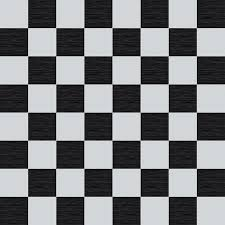

In [4]:
#reading the image using Image function of Ipython
Image(filename='chess_board.jpg')

In [5]:
cv_img = cv2.imread('chess_board.jpg')
#second parameter is flag and we can pass manually in what way we want to read this image, if we want color, grayscale or anything else
#FLAGS: i.e the second parameter of the imread function
# 0 -> read in grayscale 
# 1 -> read it in color format

In [6]:
cv_img.shape, cv_img.dtype

((225, 225, 3), dtype('uint8'))

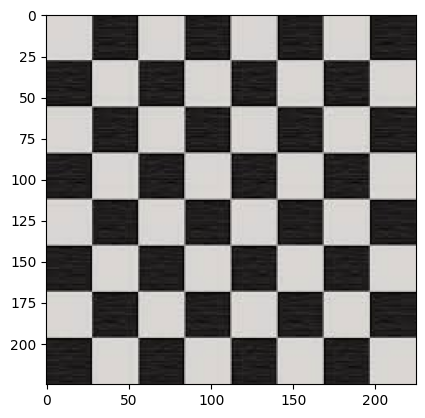

In [7]:
plt.imshow(cv_img, cmap='gray')

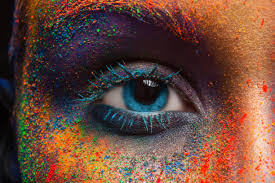

In [8]:
Image('eye_colored.jpg')

In [9]:
#instead of rjb it read in way BGR(i.e reverse of rgb) that's why the color in the below showing get reversed when rendered using pyplot because it expect it RGB format
cv_color = cv2.imread('eye_colored.jpg',1)

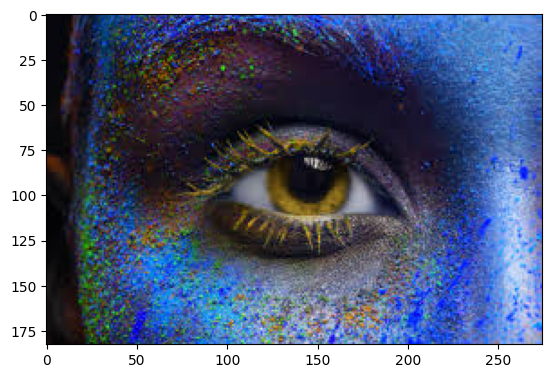

In [10]:


plt.imshow(cv_color)

In [11]:
#let's try to solve the above issue by reversing it

In [12]:
#reverse the color encoding part of the cv2 image read matrix
reversed_cv2_color_encoding = cv_color[:,:, ::-1]

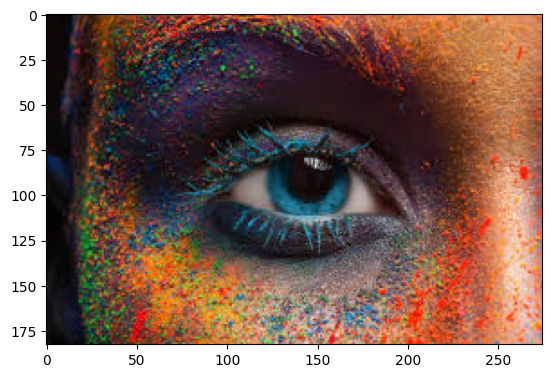

In [13]:
#now the color order are RGB, show it to the plt library 
plt.imshow(reversed_cv2_color_encoding)

# Splitting and Merging Color Channels

In [14]:
img = cv2.imread('eye_colored.jpg', cv2.IMREAD_COLOR)

In [15]:
b,g,r = cv2.split(img)

b,g,r

(array([[  7,   7,   7, ...,  97,  88,  79],
        [  7,   7,   7, ...,  59,  54,  43],
        [  7,   7,   7, ...,  52,  47,  39],
        ...,
        [ 22,  19,  15, ..., 160, 155, 149],
        [ 23,  20,  15, ..., 128, 123, 118],
        [ 24,  21,  16, ..., 112, 107, 106]], dtype=uint8),
 array([[  7,   7,   7, ..., 128, 130, 132],
        [  7,   7,   7, ..., 135, 136, 138],
        [  7,   7,   7, ..., 112, 113, 115],
        ...,
        [ 16,  13,  10, ..., 167, 161, 153],
        [ 17,  14,  10, ..., 171, 163, 153],
        [ 18,  15,  11, ..., 162, 153, 143]], dtype=uint8),
 array([[ 13,  13,  13, ..., 219, 219, 222],
        [ 13,  13,  13, ..., 248, 248, 248],
        [ 13,  13,  13, ..., 208, 208, 211],
        ...,
        [ 17,  14,  11, ..., 200, 190, 178],
        [ 18,  15,  11, ..., 255, 246, 233],
        [ 19,  16,  12, ..., 255, 248, 233]], dtype=uint8))

In [16]:
#now let's merge the color channels
#we merged by passing a tuple of these color channels
img_merged = cv2.merge((r,g,b))

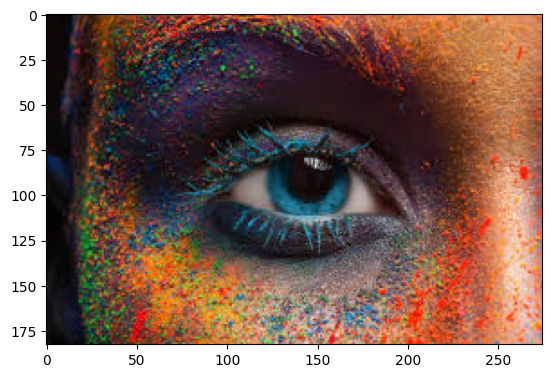

In [17]:
#showing the image
plt.imshow(img_merged)

### doing some more on split colored channels

Text(0.5, 1.0, 'MERGED CHANNEL')

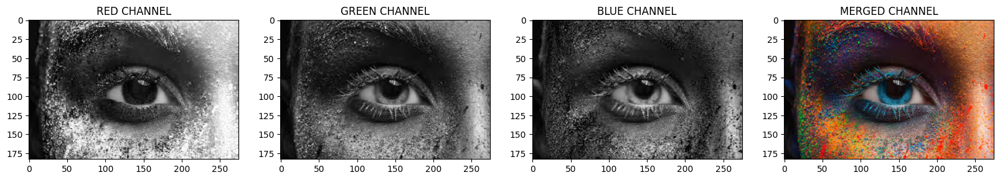

In [18]:
plt.figure(figsize=[20,5])
plt.subplot(141);plt.imshow(r, cmap = 'gray');plt.title('RED CHANNEL')
plt.subplot(142);plt.imshow(g, cmap = 'gray');plt.title('GREEN CHANNEL')
plt.subplot(143);plt.imshow(b, cmap = 'gray'); plt.title('BLUE CHANNEL')

plt.subplot(144);plt.imshow(cv2.merge((r,g,b)));plt.title('MERGED CHANNEL')

# CONVERT TO DIFFERENT COLOR SPACES

matplotlib.image.AxesImage

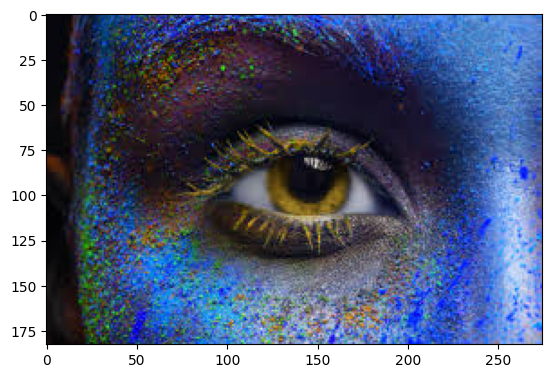

In [19]:
#usingcv2.cvtcolor to convert the color from one way to another
#refer to the documentation 
#https://docs.opencv.org/3.4/d8/d01/group__imgproc__color__conversions.html
#normally it is b,g,r colored channel 
img = cv2.imread('eye_colored.jpg')
type(plt.imshow(img))

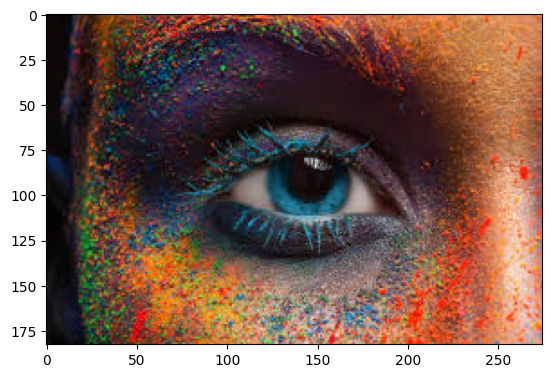

In [20]:
#convrting the color
cnvrted = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(cnvrted)

Text(0.5, 1.0, 'HSV MERGED')

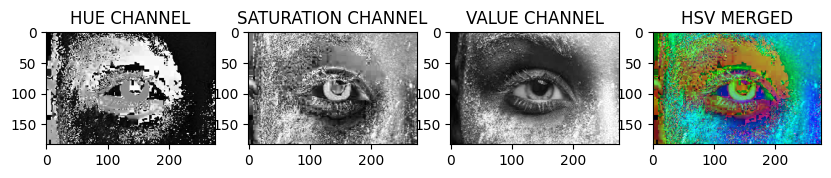

In [21]:
img_hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
h,s,v = cv2.split(img_hsv)
plt.figure(figsize = (10,10))
plt.subplot(141);plt.imshow(h, cmap = 'gray'); plt.title('HUE CHANNEL')
plt.subplot(142); plt.imshow(s, cmap = 'gray'); plt.title('SATURATION CHANNEL')
plt.subplot(143); plt.imshow(v, cmap = 'gray'); plt.title('VALUE CHANNEL')
plt.subplot(144); plt.imshow(cv2.merge((h,s,v))); plt.title('HSV MERGED') 
# plt.subplot(145);plt.imshow(img);plt.title('original color')

### saving the image in the disc

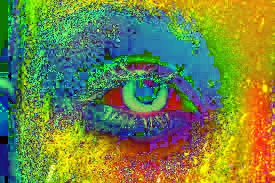

In [22]:
cv2.imwrite('hsv.jpg', img_hsv)
Image('hsv.jpg')

# IMAGE MANIPULATION WITH OPENCV

### accessing individual pixel in a image

In [23]:
img = cv2.imread('chess_board.jpg', 0) #reading the image in grayscale

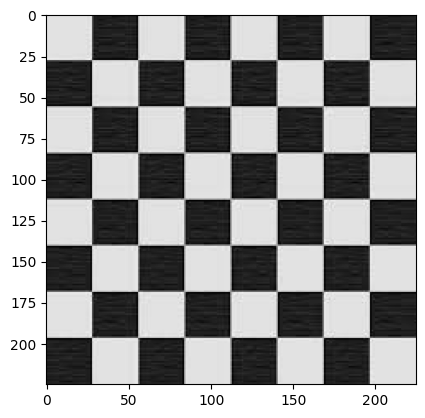

In [24]:
plt.imshow(img, cmap = "gray")

In [25]:
img

array([[214, 214, 214, ...,  29,  30,  31],
       [214, 214, 214, ...,  29,  29,  36],
       [214, 214, 214, ...,  34,  34,  37],
       ...,
       [ 21,  21,  22, ..., 214, 214, 214],
       [ 30,  30,  31, ..., 214, 214, 214],
       [ 31,  31,  32, ..., 214, 214, 214]], dtype=uint8)

In [26]:
img.shape

(225, 225)

In [27]:
img[0][-1]

31

In [28]:
cpy_img = img.copy()

In [29]:
# cpy_img[0][:] = 255
# # cpy_img[0][-2] = 255
# # cpy_img[0][-3] = 255

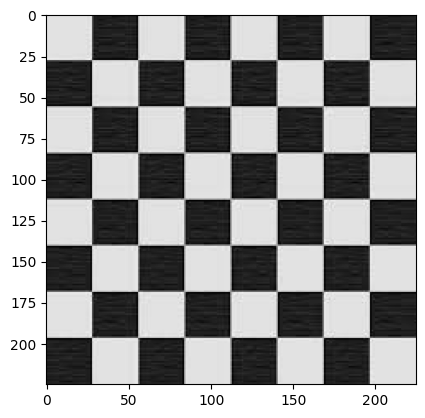

In [30]:
plt.imshow(cpy_img, cmap = "gray")

In [31]:
#modyfing the pixels value
#tsingle below statement set second row and second column value to 200
cpy_img[2,2] = 20
cpy_img[2,3] = 20
cpy_img[3,2] =20
cpy_img[3,3] =20

#doing all the above operation in a single line
# cpy_img[2:3,2:3] = 20

In [32]:
cpy_img


array([[214, 214, 214, ...,  29,  30,  31],
       [214, 214, 214, ...,  29,  29,  36],
       [214, 214,  20, ...,  34,  34,  37],
       ...,
       [ 21,  21,  22, ..., 214, 214, 214],
       [ 30,  30,  31, ..., 214, 214, 214],
       [ 31,  31,  32, ..., 214, 214, 214]], dtype=uint8)

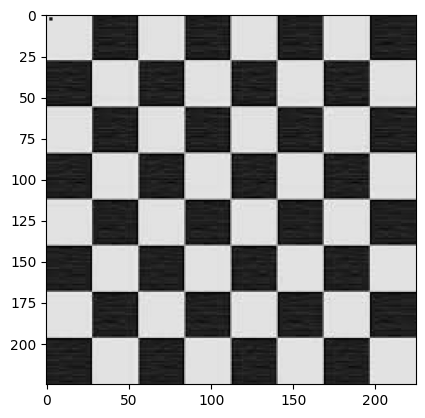

In [33]:
plt.imshow(cpy_img, cmap = "gray")

### Cropping Images

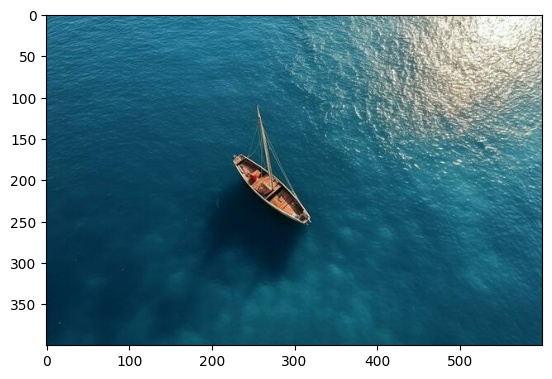

In [34]:
boat_img = cv2.imread('boat.jpg', cv2.IMREAD_COLOR)
img_rgb= boat_img[:,:, ::-1]
plt.imshow(img_rgb)

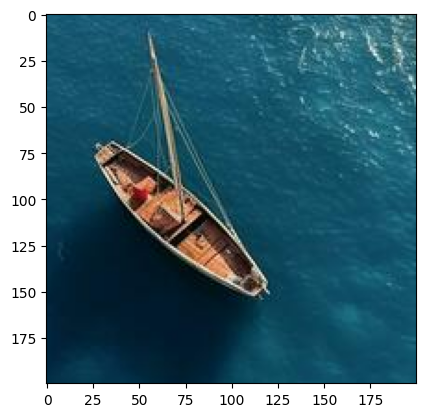

In [35]:
#the axis in the above image have pixel values
#let's crop the image and get the boat
cropped_region = img_rgb[100:300, 200:400]

plt.imshow(cropped_region)

### Resizing an image

In [36]:
img = cv2.imread('boat.jpg', cv2.IMREAD_COLOR)


In [37]:
#resize, interpolation is not required
resize_img = cv2.resize(img, None, fx = 0.5, fy=0.5, interpolation = cv2.INTER_AREA )

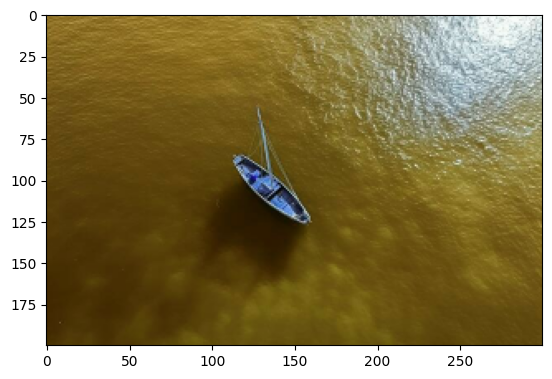

In [38]:
plt.imshow(resize_img)

In [39]:
# we can exactly do it by passing the pixels value in dm and dy as well
resize_width = 100
resize_hight = 200
dim = (resize_width, resize_hight)
resize_img = cv2.resize(img, dsize= dim ,interpolation = cv2.INTER_AREA )

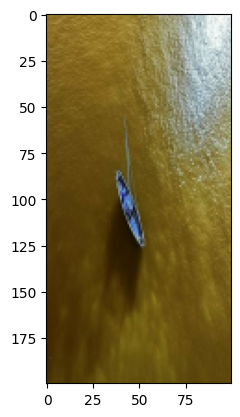

In [40]:
plt.imshow(resize_img)

In [41]:
img.shape

(400, 600, 3)

In [42]:
#doing the resize by maintaining the aspect ration
res_width = 100
original_height_width = img.shape
print(original_height_width)
aspect_ratio = res_width/original_height_width[1]
new_hight = int(original_height_width[0] * aspect_ratio)
res_dim = (res_width, new_hight)
res_dim

(400, 600, 3)


(100, 66)

In [43]:
res_aspect_ration_img = cv2.resize(img, dsize = res_dim, interpolation = cv2.INTER_AREA)

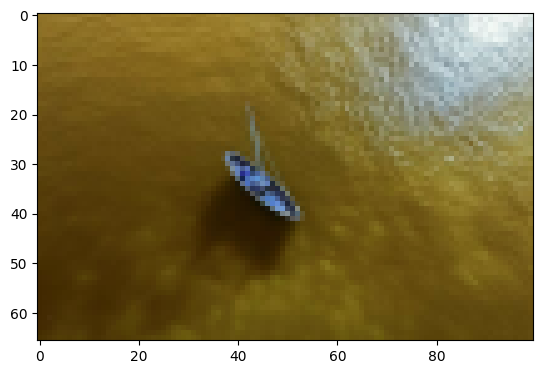

In [44]:
plt.imshow(res_aspect_ration_img)

In [45]:
cv2.imwrite('resize_boat.jpg', res_aspect_ration_img)

True

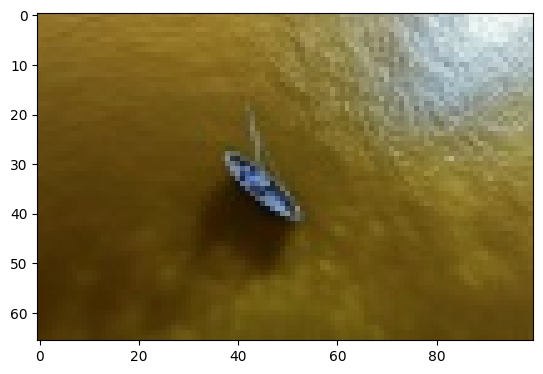

In [46]:
read_resized = cv2.imread('resize_boat.jpg', cv2.IMREAD_COLOR)
plt.imshow(read_resized, cmap = "gray")

### IMAGE ANNOTATION

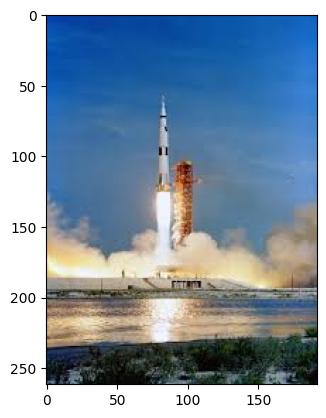

In [47]:
apollo_img = cv2.imread('apollo.jpg', cv2.IMREAD_COLOR)
plt.imshow(apollo_img[:,:,::-1])

In [48]:
#making a copy of the image
img_line = apollo_img.copy()

In [49]:
#draw a line on img_line image from pixel (10,50) point to (150,50), giving the rgb value of the line
flush = cv2.line(img_line,(10,50), (150,50), color = (0,255,255), thickness = 5, lineType = cv2.LINE_AA)

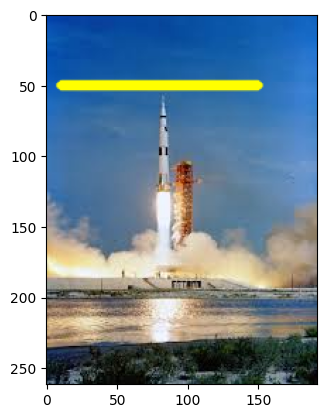

In [50]:
plt.imshow(img_line[:,:,::-1])

In [51]:
#drawing the rectangle
img_rec = apollo_img.copy()
#we need to give two coordinates, top left and bottom right
flusing_the_output = cv2.rectangle(img_rec, (50,50), (125,175), color = (0,255,255), thickness = -2)

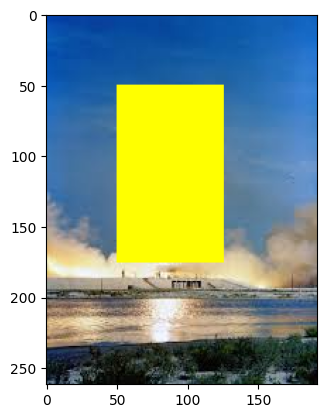

In [52]:
plt.imshow(img_rec[:,:,::-1])

In [53]:
circle_img = apollo_img.copy()
#drawing the circle on the image, we are flushing the output since not required
#color is a bgr color given
flush_optpt = cv2.circle(circle_img, (90,110), 60, color = (0,255,255), thickness = 2 )

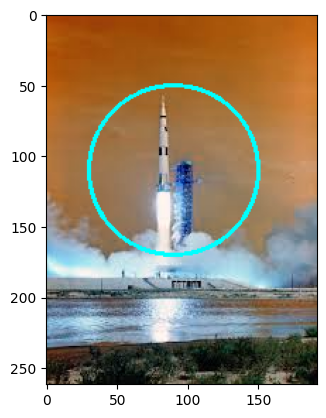

In [54]:
plt.imshow(circle_img)

In [55]:
#writing the text on the image

text_img = apollo_img.copy()
text = "apollo11 saturn V launch, July 16, 1969"
fontScale = 0.75
#font face is font type
fontFace = cv2.FONT_HERSHEY_PLAIN
fontColor = (200,200,200)
fontThickness = 1
#org is the origin of the text i.e pixel value where the bottom left of the text should be placed
flush_opt = cv2.putText(text_img, text, org = (10,225), fontFace = fontFace, fontScale = fontScale, color = (0,255,255), thickness = fontThickness)

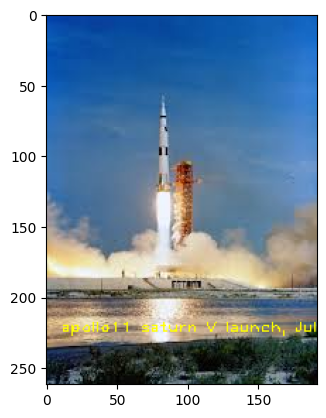

In [56]:
plt.imshow(text_img[:,:, ::-1])

### IMAGE INHANCEMENT

In [57]:
import numpy as np

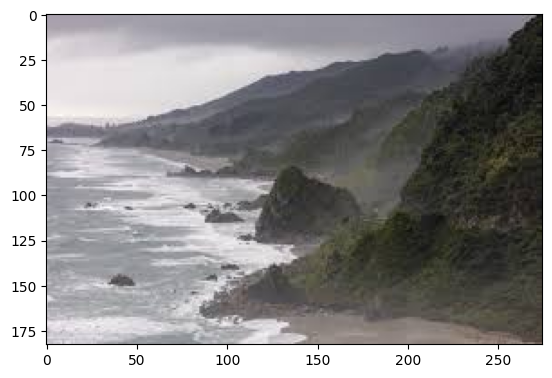

In [58]:
new_zealand_img = cv2.imread('new_zealand_img.jpg', cv2.IMREAD_COLOR)
plt.imshow(new_zealand_img[:,:,::-1])

In [59]:
operation_matrix = np.ones(new_zealand_img.shape, dtype = "uint8")

In [60]:
#setting each pixel value to 50
operation_matrix*150

array([[[150, 150, 150],
        [150, 150, 150],
        [150, 150, 150],
        ...,
        [150, 150, 150],
        [150, 150, 150],
        [150, 150, 150]],

       [[150, 150, 150],
        [150, 150, 150],
        [150, 150, 150],
        ...,
        [150, 150, 150],
        [150, 150, 150],
        [150, 150, 150]],

       [[150, 150, 150],
        [150, 150, 150],
        [150, 150, 150],
        ...,
        [150, 150, 150],
        [150, 150, 150],
        [150, 150, 150]],

       ...,

       [[150, 150, 150],
        [150, 150, 150],
        [150, 150, 150],
        ...,
        [150, 150, 150],
        [150, 150, 150],
        [150, 150, 150]],

       [[150, 150, 150],
        [150, 150, 150],
        [150, 150, 150],
        ...,
        [150, 150, 150],
        [150, 150, 150],
        [150, 150, 150]],

       [[150, 150, 150],
        [150, 150, 150],
        [150, 150, 150],
        ...,
        [150, 150, 150],
        [150, 150, 150],
        [150, 150, 150]]

Text(0.5, 1.0, 'lighter image')

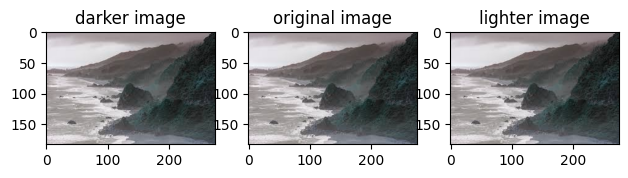

In [61]:
#MAKING DARKER OR LIGHTER

darker_img = cv2.add(new_zealand_img, operation_matrix)
lighter_img = cv2.subtract(new_zealand_img, operation_matrix)
plt.figure(figsize = (10,10))
plt.subplot(141); plt.imshow(darker_img);plt.title("darker image")
plt.subplot(142);plt.imshow(new_zealand_img); plt.title("original image")
plt.subplot(143);plt.imshow(lighter_img); plt.title("lighter image")

##### CONTRAST

In [62]:
matrix1 = np.ones(new_zealand_img.shape)* 0.8
matrix2 = np.ones(new_zealand_img.shape)*1.2

Text(0.5, 1.0, 'lighter')

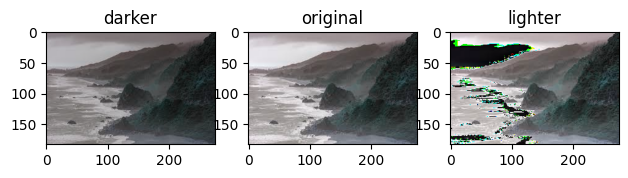

In [63]:
img_rgb_darker = np.uint8(np.multiply(np.float64(new_zealand_img) , matrix1))
img_rgb_lighter = np.uint8(np.multiply(np.float64(new_zealand_img), matrix2))
plt.figure(figsize=(10,10))
plt.subplot(141);plt.imshow(img_rgb_darker); plt.title('darker')
plt.subplot(142);plt.imshow(new_zealand_img); plt.title('original')
plt.subplot(143);plt.imshow(img_rgb_lighter);plt.title('lighter')

In [64]:
#if we see in the last image , on multiplication the value would have rotated and started from on onwards and hence the third image look a bit off
#let's fix it by using CLIPPING


Text(0.5, 1.0, 'higher contrast')

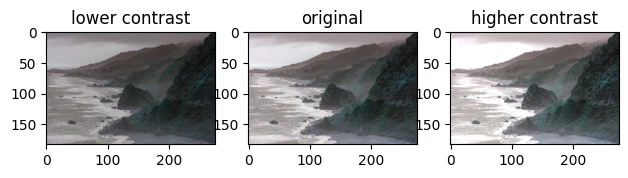

In [65]:
img_rgb_lower = np.uint8(np.multiply(np.float64(new_zealand_img) , matrix1))
img_rgb_higher = np.uint8(np.clip(np.multiply(np.float64(new_zealand_img), matrix2), 0, 255))
plt.figure(figsize=(10,10))
plt.subplot(141);plt.imshow(img_rgb_lower); plt.title('lower contrast')
plt.subplot(142);plt.imshow(new_zealand_img); plt.title('original')
plt.subplot(143);plt.imshow(img_rgb_higher);plt.title('higher contrast')

##### IMAGE THRESHOLDING

In [66]:
#whatever threshold value we specify the pixels value below that will be set to 0 and the ones above will be set 255

In [67]:
img_read  = cv2.imread('new_zealand_img.jpg', cv2.IMREAD_GRAYSCALE)
retval, img_thres_gbl_1 = cv2.threshold(img_read, 50, 255, cv2.THRESH_BINARY)
retval, img_thres_gbl2 = cv2.threshold(img_read, 100, 255, cv2.THRESH_BINARY)

Text(0.5, 1.0, 'threshold(100) global')

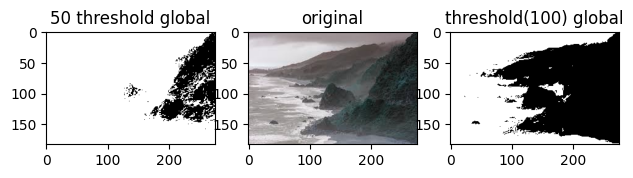

In [68]:
plt.figure(figsize=(10,10))
plt.subplot(141);plt.imshow(img_thres_gbl_1, cmap = "gray"); plt.title('50 threshold global')
plt.subplot(142);plt.imshow(new_zealand_img, cmap = "gray" ); plt.title('original')
plt.subplot(143);plt.imshow(img_thres_gbl2, cmap = "gray" );plt.title('threshold(100) global')




In [69]:
arr1 = np.array([200, 250], dtype=np.uint8).reshape(-1, 1)
arr1

array([[200],
       [250]], dtype=uint8)

### ACCESSING THE CAMERA

###### below code should be executed from a python file for better viewing experience

In [70]:
import cv2
import sys

#we will be using the default camera
camera_no = 0
#if we want to read from some other camera then we can pass that value
if len(sys.argv) > 1:
    camera_no = sys.argv[1]

#creating a video capture object
device = cv2.VideoCapture(camera_no)

#creating a window to show the video

window = cv2.namedWindow('default', cv2.WINDOW_AUTOSIZE)

#until someone doesn't press the escape key
while cv2.waitKey(0) != 27:
    has_frame, frame  = device.read()
    if not has_frame:
        break
    cv2.imshow(window, frame)

device.release()
cv2.destroyWindow(window)

error: OpenCV(4.11.0) D:\a\opencv-python\opencv-python\opencv\modules\highgui\src\window_w32.cpp:1261: error: (-27:Null pointer) NULL window: '' in function 'cvDestroyWindow'


In [ ]:
#reading video capture can read from a local video, locallist of images , webcam

device = cv2.VideoCapture('video.mp4')
device

In [ ]:
#read a frame
_,frame = device.read()

In [ ]:
#it's a bgr image that's all
frame.shape

In [ ]:
#display the frame
plt.imshow(frame[:,:,::-1])

In [ ]:
#rendering the video
from IPython.display import HTML
HTML("""
<video width=480 controls>
<source src="video.mp4" type = "video/mp4">
</video>
""")

### IMAGE FEATURES AND ALIGNMENT

In [ ]:
Image('type_of_image_transformations.jpg')

## Theory

2. Images of two planes are related by a **Homography**
3. We need **4 corresponding points** to estimate Homography


!["Homography Example"](https://learnopencv.com/wp-content/uploads/2023/03/opencv_bootcamp_08_homography-example.jpg)

In [136]:
def download_and_unzip(url, save_path):
    print(f"Downloading and extracting assests....", end="")

    # Downloading zip file using urllib package.
    urlretrieve(url, save_path)

    try:
        # Extracting zip file using the zipfile package.
        with ZipFile(save_path) as z:
            # Extract ZIP file contents in the same directory.
            z.extractall(os.path.split(save_path)[0])

        print("Done")

    except Exception as e:
        print("\nInvalid file.", e)

In [138]:
from zipfile import ZipFile
from urllib.request import urlretrieve

In [ ]:

URL = r"https://www.dropbox.com/s/zuwnn6rqe0f4zgh/opencv_bootcamp_assets_NB8.zip?dl=1"

asset_zip_path = os.path.join(os.getcwd(), "opencv_bootcamp_assets_NB8.zip")

# Download if assest ZIP does not exists. 
if not os.path.exists(asset_zip_path):
    download_and_unzip(URL, asset_zip_path)   

In [109]:
# Read reference image
refFilename = "form.jpg"
print("Reading reference image:", refFilename)
im1 = cv2.imread(refFilename, cv2.IMREAD_COLOR)
im1 = cv2.cvtColor(im1, cv2.COLOR_BGR2RGB)

# Read image to be aligned
imFilename = "scanned-form.jpg"
print("Reading image to align:", imFilename)
im2 = cv2.imread(imFilename, cv2.IMREAD_COLOR)
im2 = cv2.cvtColor(im2, cv2.COLOR_BGR2RGB)

Reading reference image: form.jpg
Reading image to align: scanned-form.jpg


Text(0.5, 1.0, 'Scanned Form')

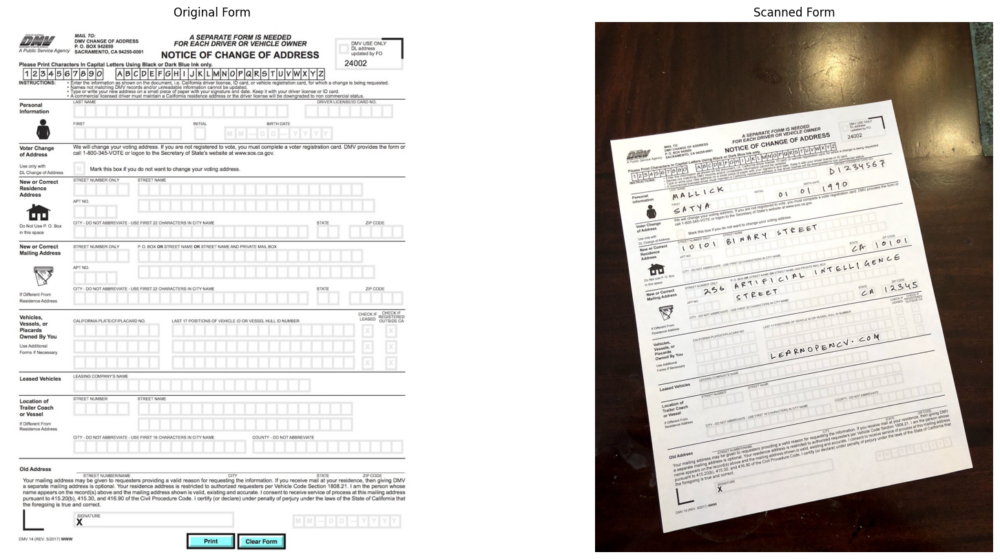

In [110]:
# Display Images

plt.figure(figsize=[20, 10]); 
plt.subplot(121); plt.axis('off'); plt.imshow(im1); plt.title("Original Form")
plt.subplot(122); plt.axis('off'); plt.imshow(im2); plt.title("Scanned Form")

In [129]:
#gray scaling the image
img1_gray = cv2.cvtColor(im1, cv2.COLOR_BGR2GRAY)
img2_gray = cv2.cvtColor(im2, cv2.COLOR_BGR2GRAY)

#detect orb freatures and compute descriptors
max_num_features = 50
orb = cv2.ORB_create()
keypoints1, descriptors1 = orb.detectAndCompute(img1_gray, None)
keypoints2, descriptors2 = orb.detectAndCompute(img2_gray, None)
im1_display  = cv2.drawKeypoints(im1, keypoints1, None, color = (255,0,0 ), flags = cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
im2_display  = cv2.drawKeypoints(im2, keypoints2, None, color = (255,0,0 ), flags = cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)


Text(0.5, 1.0, 'SCANNED IMAGE')

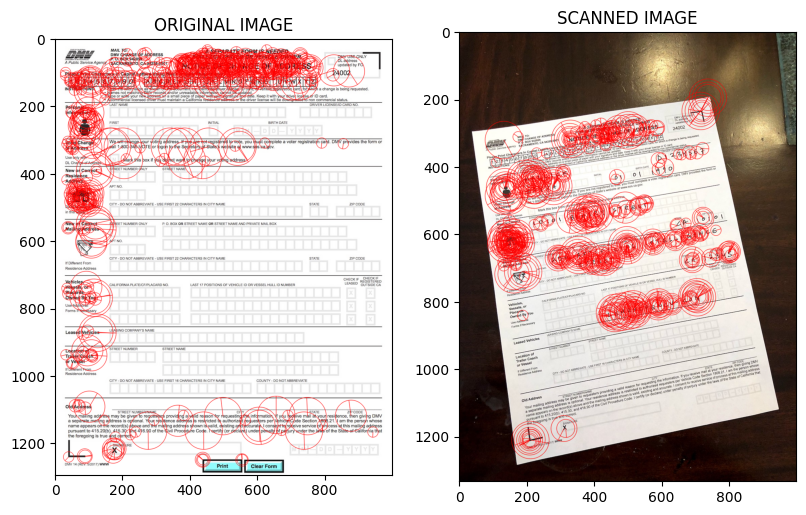

In [130]:
plt.figure(figsize = (20,20))
plt.subplot(141); plt.imshow(im1_display); plt.title("ORIGINAL IMAGE")
plt.subplot(142); plt.imshow(im2_display); plt.title("SCANNED IMAGE")


##### match keypoints in the two images

In [131]:
matcher = cv2.DescriptorMatcher_create(cv2.DESCRIPTOR_MATCHER_BRUTEFORCE_HAMMING)
matches = list(matcher.match(descriptors1, descriptors2, None))
# print(matches[0].distance)
matches.sort(key =lambda x: x.distance, reverse = True)
numGoodMatches = int(len(matches)*0.5) #take only 50% of the matches
matches = matches[:numGoodMatches]

Text(0.5, 1.0, 'Original Form')

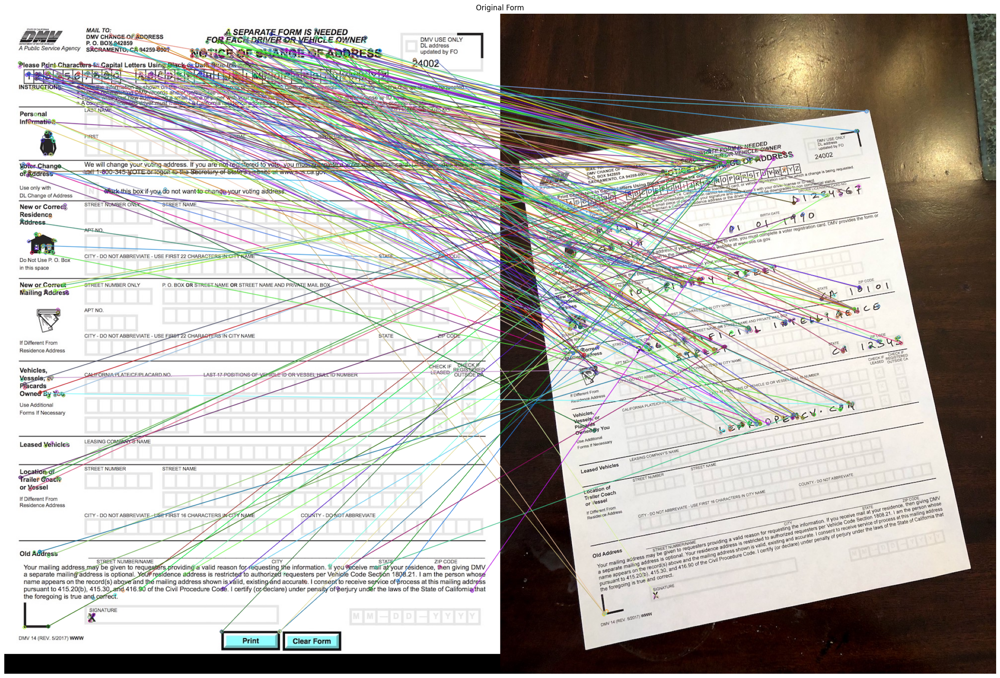

In [132]:
im_matches = cv2.drawMatches(im1, keypoints1, im2, keypoints2, matches, None)
plt.figure(figsize=[30,20])
plt.imshow(im_matches); plt.axis('off');plt.title("Original Form")

##### finding homography

In [133]:
# Extract location of good matches
points1 = np.zeros((len(matches), 2), dtype = np.float32)
points2 = np.zeros((len(matches), 2), dtype = np.float32)

for i,match in enumerate(matches):
    points1[i,:] = keypoints1[match.queryIdx].pt
    points2[i,:] = keypoints2[match.trainIdx].pt

#find homography
h,mask = cv2.findHomography(points1, points2, cv2.RANSAC)


##### warp image

Text(0.5, 1.0, 'Scanned Form')

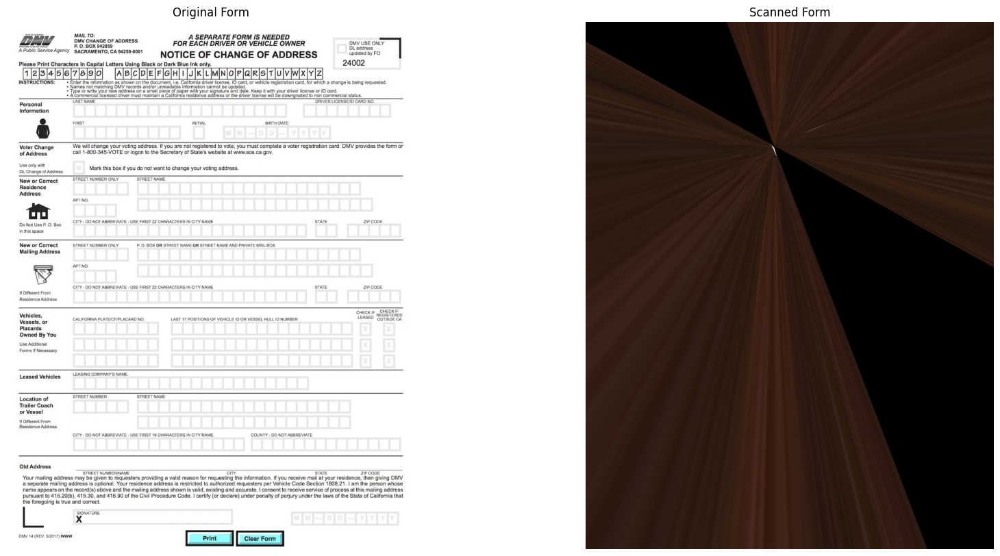

In [134]:
height, width, channels = im1.shape
im2_reg = cv2.warpPerspective(im2, h, (width, height))
#display results
# Display results
plt.figure(figsize=[20, 10])
plt.subplot(121);plt.imshow(im1);    plt.axis("off");plt.title("Original Form")
plt.subplot(122);plt.imshow(im2_reg);plt.axis("off");plt.title("Scanned Form")

### Panorma

In [139]:
URL = r"https://www.dropbox.com/s/0o5yqql1ynx31bi/opencv_bootcamp_assets_NB9.zip?dl=1"

asset_zip_path = os.path.join(os.getcwd(), f"opencv_bootcamp_assets_NB9.zip")

# Download if assest ZIP does not exists. 
if not os.path.exists(asset_zip_path):
    download_and_unzip(URL, asset_zip_path) 

In [140]:
import glob
import math

In [141]:
imagefiles = glob.glob(f"./boat/*")

In [144]:
imagefiles.sort()
imagefiles

['./boat\\boat1.jpg',
 './boat\\boat2.jpg',
 './boat\\boat3.jpg',
 './boat\\boat4.jpg',
 './boat\\boat5.jpg',
 './boat\\boat6.jpg']

In [148]:
images = []

for image in imagefiles:
    img = cv2.imread(image)
    images.append(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
len(images)

6

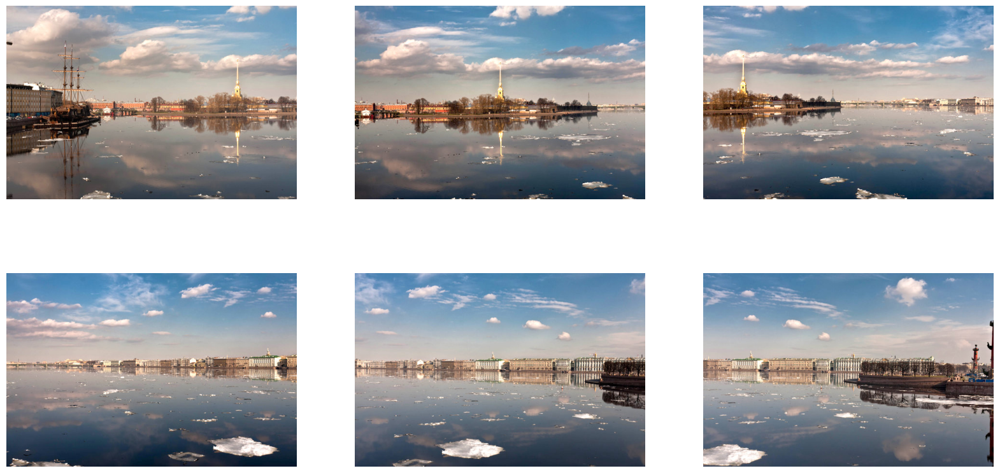

In [158]:
plt.figure(figsize = (20,10))
no_of_cols = 3
no_of_rows = math.ceil(len(images)/no_of_cols)
for i in range(0,len(images)):
    plt.subplot(no_of_rows, no_of_cols, i+1)
    plt.imshow(images[i])
    plt.axis("off")
    

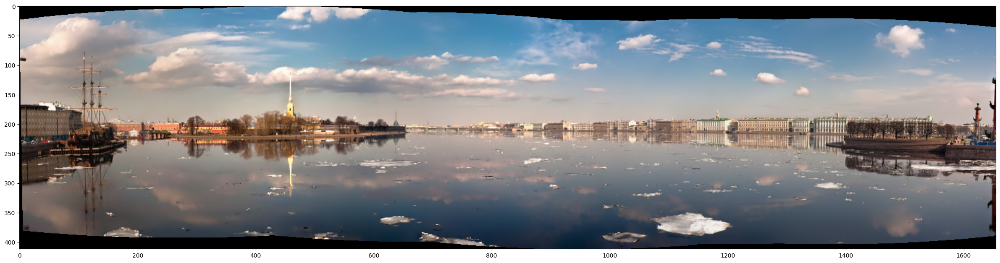

In [162]:
stitcher = cv2.Stitcher_create()
status, panorma =stitcher.stitch(images)
# plt.imshow(panorma)
if status == 0:
    plt.figure(figsize = (30,10))
    plt.imshow(panorma)

### HDR(HIGH DYNAMIC RANGE(HDR) imaging)

In [164]:
URL = r"https://www.dropbox.com/s/qa1hsyxt66pvj02/opencv_bootcamp_assets_NB10.zip?dl=1"

asset_zip_path = os.path.join(os.getcwd(), "opencv_bootcamp_assets_NB10.zip")

# Download if assest ZIP does not exists.
if not os.path.exists(asset_zip_path):
    download_and_unzip(URL, asset_zip_path)

### Basic Idea

1. The **dynamic range** of images is limited to 8-bits (0 - 255) per channel
2. Very bright pixels saturate to 255
3. Very dark pixels clip to 0

### 
[link text](https://)# Step 1: Capture Multiple Exposures

!["HDR Image Sequence"](https://learnopencv.com/wp-content/uploads/2023/03/opencv_bootcamp_10_hdr-image-sequence.jpg)

In [175]:
img_glob = glob.glob('./opencv_bootcamp_assets_NB10/*')
img_glob

['./opencv_bootcamp_assets_NB10\\img_0.033.jpg',
 './opencv_bootcamp_assets_NB10\\img_0.25.jpg',
 './opencv_bootcamp_assets_NB10\\img_15.jpg',
 './opencv_bootcamp_assets_NB10\\img_2.5.jpg']

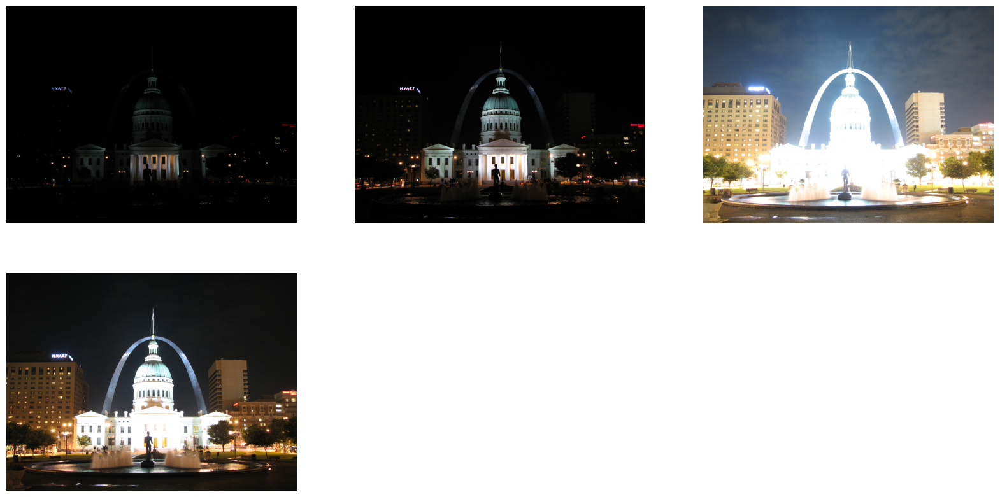

In [177]:
images = []

# we need to have images of various light exposure to create hdr image
for image in img_glob:
    img = cv2.imread(image)
    images.append(img[:, :, ::-1])
len(images)
plt.figure(figsize = (20,10))
no_of_cols = 3
no_of_rows = math.ceil(len(images)/no_of_cols)
for i in range(0,len(images)):
    plt.subplot(no_of_rows, no_of_cols, i+1)
    plt.imshow(images[i])
    plt.axis("off")
    

In [180]:
#times of exposure which we have in the images names given
times = np.array([1 / 30.0, 0.25, 2.5, 15.0], dtype=np.float32)
images, times

([array([[[0, 0, 0],
          [0, 0, 0],
          [0, 0, 0],
          ...,
          [0, 0, 0],
          [0, 0, 0],
          [0, 0, 0]],
  
         [[0, 0, 0],
          [0, 0, 0],
          [0, 0, 0],
          ...,
          [0, 0, 0],
          [0, 0, 0],
          [0, 0, 0]],
  
         [[1, 1, 1],
          [1, 1, 1],
          [1, 1, 1],
          ...,
          [0, 0, 0],
          [0, 0, 0],
          [0, 0, 0]],
  
         ...,
  
         [[0, 0, 0],
          [0, 0, 0],
          [0, 0, 0],
          ...,
          [1, 1, 1],
          [0, 0, 0],
          [0, 0, 0]],
  
         [[0, 0, 0],
          [0, 0, 0],
          [0, 0, 0],
          ...,
          [0, 0, 0],
          [0, 0, 0],
          [0, 0, 0]],
  
         [[0, 0, 0],
          [1, 1, 1],
          [1, 1, 1],
          ...,
          [0, 0, 0],
          [0, 0, 0],
          [0, 0, 0]]], dtype=uint8),
  array([[[0, 0, 0],
          [0, 0, 0],
          [0, 0, 0],
          ...,
          [0, 0, 0],
  

##### align images

In [181]:
#MTB median threshold bitmap , this below function is used for aligning images of different exposure
alignMTB = cv2.createAlignMTB()
#inplace doing the alogiment
alignMTB.process(images, images)

##### estimate camera response function

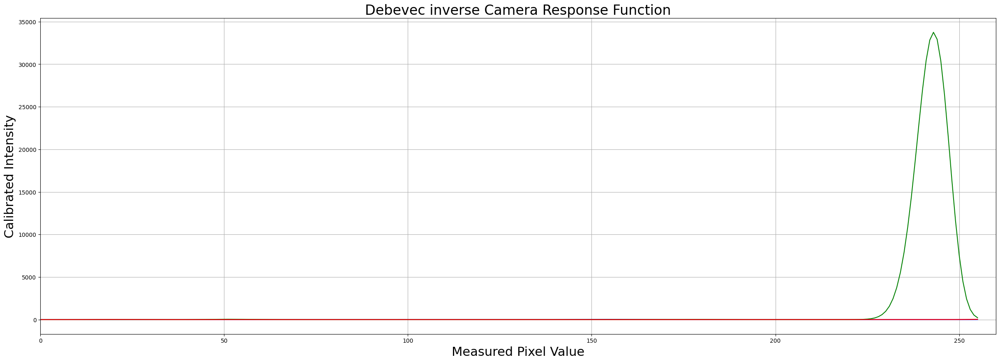

In [183]:
# Find Camera Response Function(CRF)
caliberateDebevec = cv2.createCalibrateDebevec()
responseDebevec = caliberateDebevec.process(images, times)
#plot CRF
x = np.arange(256, dtype = np.uint8)
y = np.squeeze(responseDebevec)
ax = plt.figure(figsize = (30,10))
plt.title("Debevec inverse Camera Response Function", fontsize = 24)
plt.xlabel("Measured Pixel Value", fontsize=22)
plt.ylabel("Calibrated Intensity", fontsize=22)
plt.xlim([0, 260])
plt.grid()
plt.plot(x, y[:, 0], "b", x, y[:, 1], "g", x, y[:, 2], "r")

In [184]:
# Merge images into an HDR linear image
mergeDebevec = cv2.createMergeDebevec()
hdrDebevec = mergeDebevec.process(images, times, responseDebevec)

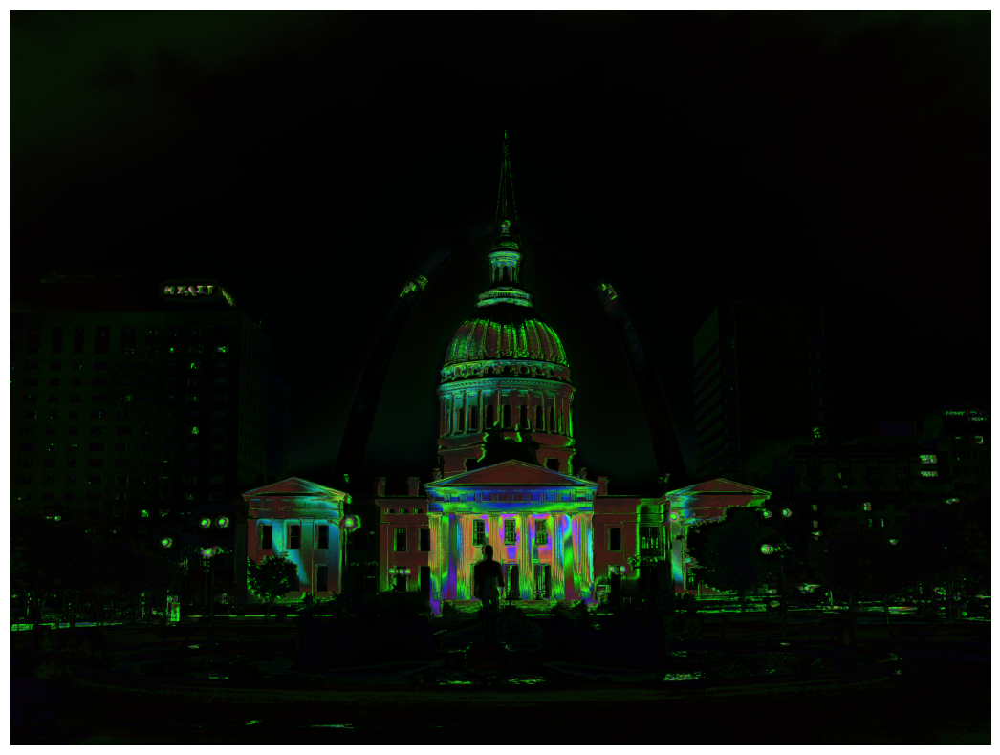

In [185]:
# Tonemap using Drago's method to obtain 24-bit color image
tonemapDrago = cv2.createTonemapDrago(1.0, 0.7)
ldrDrago = tonemapDrago.process(hdrDebevec)
ldrDrago = 3 * ldrDrago

# Saving image
cv2.imwrite("ldr-Drago.jpg", 255*ldrDrago)

# Plotting image
plt.figure(figsize=(20, 10));plt.imshow(np.clip(ldrDrago, 0, 1)[:,:,::-1]);plt.axis("off");

Tonemaping using Reinhard's method ... 


(-0.5, 2815.5, 2111.5, -0.5)

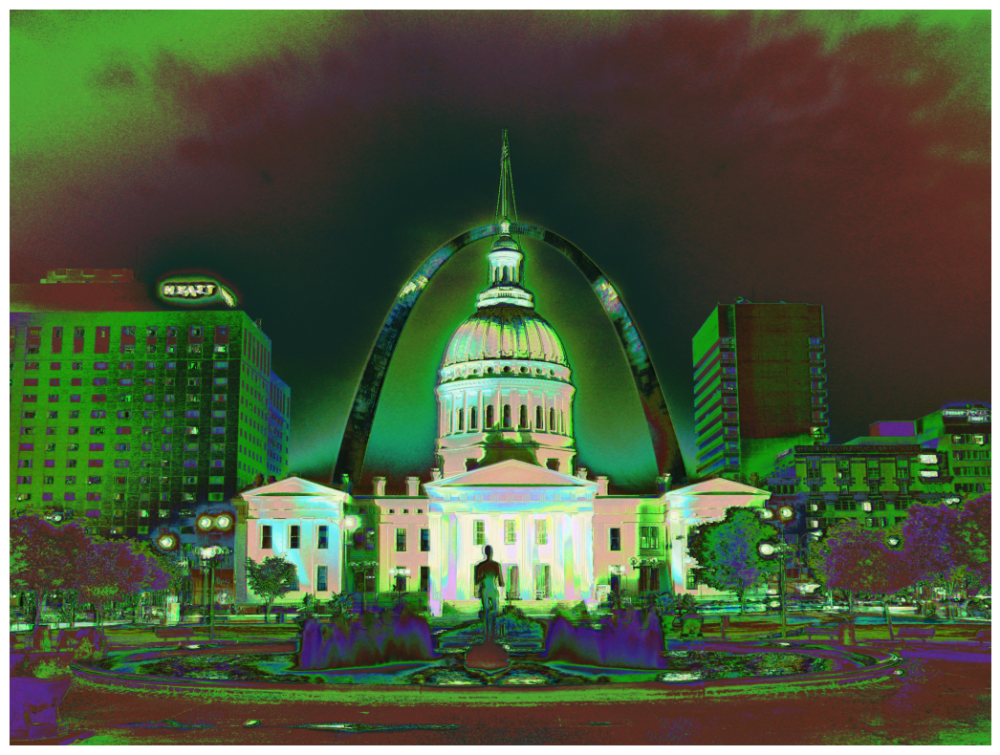

In [186]:
# Tonemap using Reinhard's method to obtain 24-bit color image
print("Tonemaping using Reinhard's method ... ")
tonemapReinhard = cv2.createTonemapReinhard(1.5, 0, 0, 0)
ldrReinhard = tonemapReinhard.process(hdrDebevec)

# Saving image
cv2.imwrite("ldr-Reinhard.jpg", ldrReinhard * 255)

# Plotting image
plt.figure(figsize=(20, 10));plt.imshow(np.clip(ldrReinhard, 0, 1)[:,:,::-1]);plt.axis("off")

Tonemaping using Mantiuk's method ... 


(-0.5, 2815.5, 2111.5, -0.5)

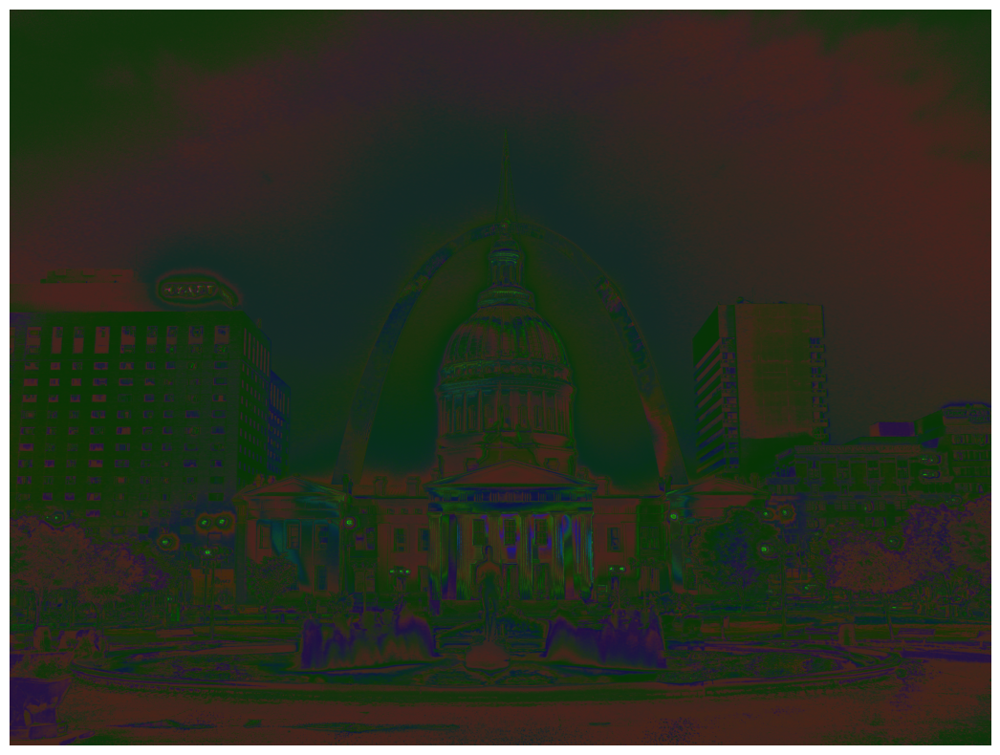

In [187]:
# Tonemap using Mantiuk's method to obtain 24-bit color image
print("Tonemaping using Mantiuk's method ... ")
tonemapMantiuk = cv2.createTonemapMantiuk(2.2, 0.85, 1.2)
ldrMantiuk = tonemapMantiuk.process(hdrDebevec)
ldrMantiuk = 3 * ldrMantiuk

# save the image using cv2.imwrite
cv2.imwrite("ldr-Mantiuk.jpg", ldrMantiuk * 255)

# plot the image using plt.imshow
plt.figure(figsize=(20, 10));plt.imshow(np.clip(ldrMantiuk, 0, 1)[:,:,::-1]);plt.axis("off")